In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [ ]:
!pwd

/content


In [ ]:
import torch

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device


device(type='cuda')

In [ ]:
# ---------------------------------------------
# 1. IMPORT LIBRARIES
# ---------------------------------------------
import pandas as pd
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import seaborn as sns

# Make plots look nicer
sns.set(style="whitegrid")


# ---------------------------------------------
# 2. READ THE DATA
# ---------------------------------------------
path = "/content/gdrive/MyDrive/subtask2/eng-train-task2.csv"
df = pd.read_csv(path)

print("Dataset shape:", df.shape)
df.head()


Dataset shape: (3222, 7)


,id,text,political,racial/ethnic,religious,gender/sexual,other
0,eng_973938b90b0ff5d87d35a582f83f5c89,is defending imperialism in the dnd chat,0,0,0,0,0
1,eng_07dfd4600426caca6e2c5883fcbea9ea,Still playing with this. I am now following Ra...,0,0,0,0,0
2,eng_f14519ff2302b6cd47712073f13bc461,.senate.gov Theres 3 groups out there Republic...,0,0,0,0,0
3,eng_e48b7e7542faafa544ac57b64bc80daf,"""ABC MD, David Anderson, said the additional f...",0,0,0,0,0
4,eng_7c581fb77bce8033aeba3d6dbd6273eb,"""bad people"" I have some conservative values s...",0,0,0,0,0


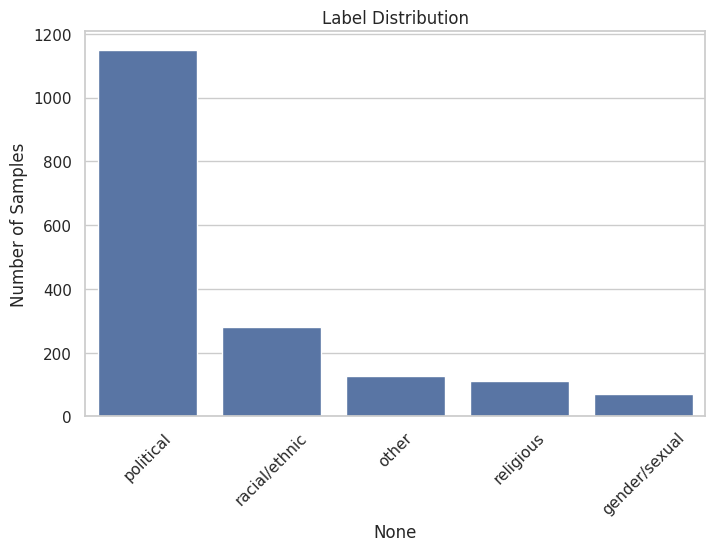

In [ ]:
# ---------------------------------------------
# 3. LABEL DISTRIBUTION
# ---------------------------------------------
label_cols = ["political", "racial/ethnic", "religious", "gender/sexual", "other"]

label_counts = df[label_cols].sum().sort_values(ascending=False)

plt.figure(figsize=(8,5))
sns.barplot(x=label_counts.index, y=label_counts.values)
plt.title("Label Distribution")
plt.ylabel("Number of Samples")
plt.xticks(rotation=45)
plt.show()


In [ ]:
label_cols = ["political", "racial/ethnic", "religious", "gender/sexual", "other"]

for col in label_cols:
    count = df[col].value_counts()
    print(f"{col}: {count}")

political: political
0    2072
1    1150
Name: count, dtype: int64
racial/ethnic: racial/ethnic
0    2941
1     281
Name: count, dtype: int64
religious: religious
0    3110
1     112
Name: count, dtype: int64
gender/sexual: gender/sexual
0    3150
1      72
Name: count, dtype: int64
other: other
0    3096
1     126
Name: count, dtype: int64


In [ ]:
label_cols = ["political", "racial/ethnic", "religious", "gender/sexual", "other"]

for col in label_cols:
    count = df[col].sum()
    print(f"{col}: {count} rows")


political: 1150 rows
racial/ethnic: 281 rows
religious: 112 rows
gender/sexual: 72 rows
other: 126 rows


Generating colored wordclouds for: political


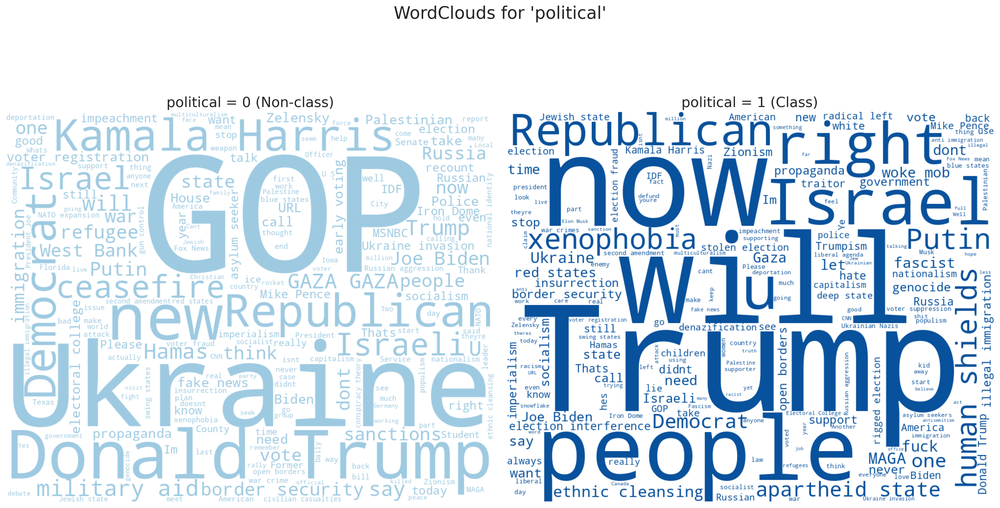

Generating colored wordclouds for: racial/ethnic


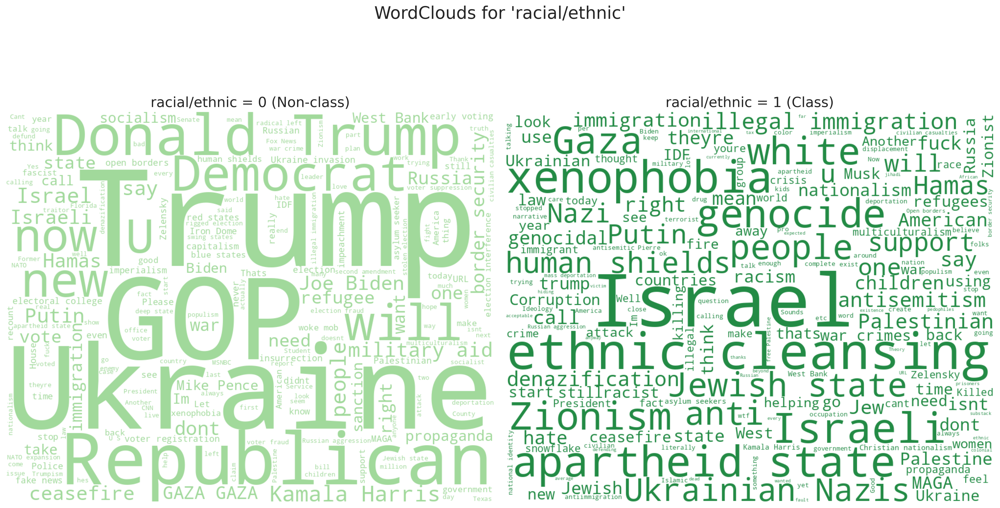

Generating colored wordclouds for: religious


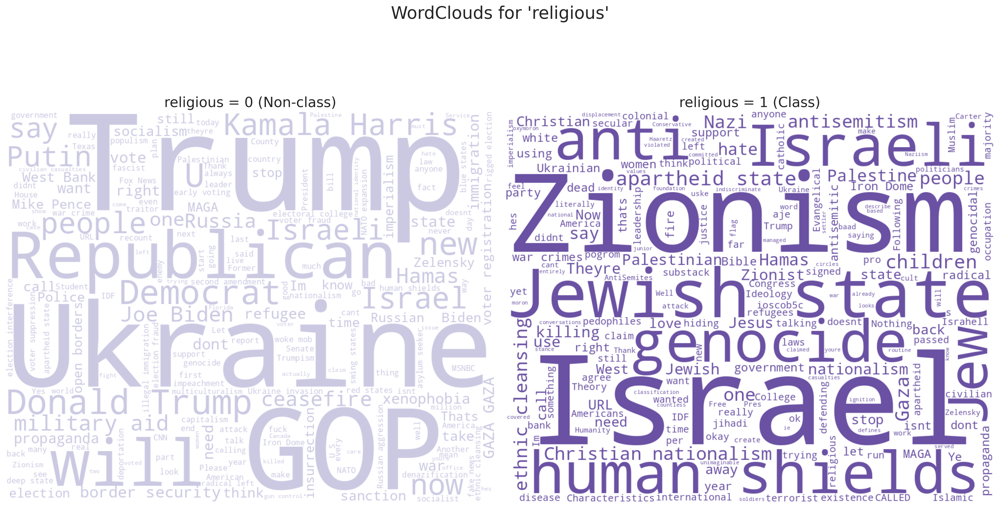

Generating colored wordclouds for: gender/sexual


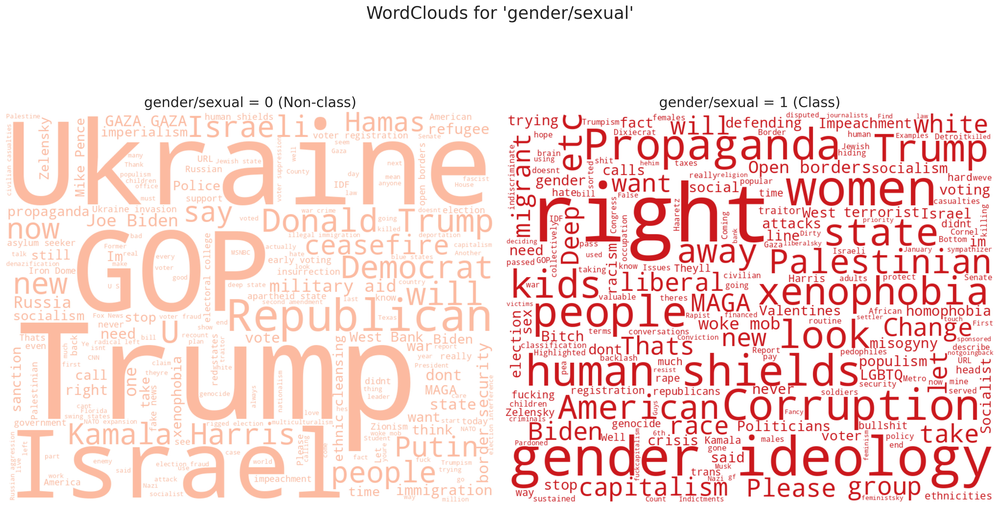

Generating colored wordclouds for: other


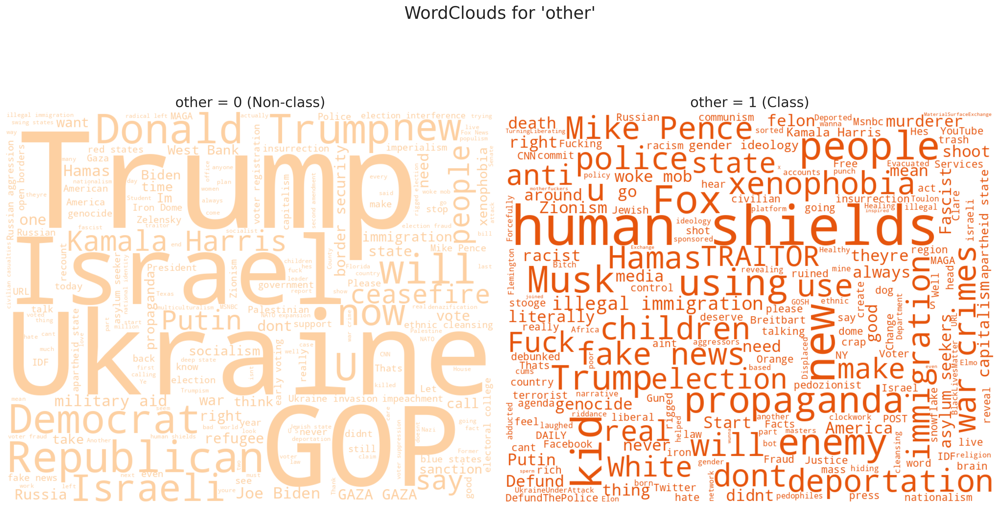

In [ ]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# Define colors for each label type and slight variations for classes 0 and 1
color_scheme = {
    "political":       ("#9ecae1", "#08519c"),  # light blue, dark blue
    "racial/ethnic":   ("#a1d99b", "#238b45"),  # light green, dark green
    "religious":       ("#cbc9e2", "#6a51a3"),  # light purple, dark purple
    "gender/sexual":   ("#fcbba1", "#cb181d"),  # light red, dark red
    "other":           ("#fdd0a2", "#e6550d")   # light orange, dark orange
}

label_cols = ["political", "racial/ethnic", "religious", "gender/sexual", "other"]

for col in label_cols:
    print(f"Generating colored wordclouds for: {col}")

    # Fetch custom colors
    color_0, color_1 = color_scheme[col]

    # Create separate word lists
    text_0 = " ".join(df[df[col] == 0]["text"].astype(str))
    text_1 = " ".join(df[df[col] == 1]["text"].astype(str))

    # Custom color functions
    def color_func_0(*args, **kwargs):
        return color_0

    def color_func_1(*args, **kwargs):
        return color_1

    # Create figure
    fig, axes = plt.subplots(1, 2, figsize=(18, 10), dpi=300)
    fig.suptitle(f"WordClouds for '{col}'", fontsize=22)

    # WordCloud for class 0
    wc0 = WordCloud(width=1000, height=800, background_color='white',
                    color_func=color_func_0).generate(text_0)
    axes[0].imshow(wc0, interpolation='bilinear')
    axes[0].set_title(f"{col} = 0 (Non-class)", fontsize=18)
    axes[0].axis('off')

    # WordCloud for class 1
    wc1 = WordCloud(width=1000, height=800, background_color='white',
                    color_func=color_func_1).generate(text_1)
    axes[1].imshow(wc1, interpolation='bilinear')
    axes[1].set_title(f"{col} = 1 (Class)", fontsize=18)
    axes[1].axis('off')

    plt.tight_layout(rect=[0, 0, 1, 0.93])
    plt.show()


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import AdamW
from torch.utils.data import Dataset, DataLoader

import pandas as pd
import numpy as np

from transformers import AutoTokenizer, AutoModelForSequenceClassification, get_linear_schedule_with_warmup
from sklearn.metrics import f1_score, precision_recall_fscore_support
from sklearn.model_selection import train_test_split

from tqdm import tqdm

# ============================================================
# 1. Dataset
# ============================================================

class TextDataset(Dataset):
    def __init__(self, df, tokenizer, max_len=128):
        self.df = df
        self.tokenizer = tokenizer
        self.max_len = max_len

        self.texts = df["text"].tolist()
        self.labels = df[["political", "racial/ethnic", "religious", "gender/sexual", "other"]].values.astype(float)

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        text = str(self.texts[idx])

        enc = self.tokenizer(
            text,
            padding="max_length",
            truncation=True,
            max_length=self.max_len,
            return_tensors="pt"
        )

        return {
            "input_ids": enc["input_ids"].squeeze(0),
            "attention_mask": enc["attention_mask"].squeeze(0),
            "labels": torch.tensor(self.labels[idx], dtype=torch.float)
        }


# ============================================================
# 2. Focal Loss with Class Weights
# ============================================================

class FocalLoss(nn.Module):
    def __init__(self, alpha, gamma=2.0, reduction="mean"):
        super().__init__()
        self.alpha = alpha  # tensor of size [num_labels]
        self.gamma = gamma
        self.reduction = reduction

    def forward(self, logits, targets):
        bce = F.binary_cross_entropy_with_logits(
            logits, targets, reduction="none"
        )

        probs = torch.sigmoid(logits)
        pt = torch.where(targets == 1, probs, 1 - probs)

        focal = (self.alpha * (1 - pt) ** self.gamma * bce)

        if self.reduction == "mean":
            return focal.mean()
        else:
            return focal.sum()


# ============================================================
# 3. Load Data
# ============================================================

df = pd.read_csv("/content/gdrive/MyDrive/subtask2/eng-train-task2.csv")
df = df.rename(columns={"label":"other"})  # only if needed

train_df, temp_df = train_test_split(df, test_size=0.2, random_state=42, shuffle=True)
val_df, test_df = train_test_split(temp_df, test_size=0.5, random_state=42)

print("Sizes -> train/val/test:", len(train_df), len(val_df), len(test_df))

# ============================================================
# 4. Compute Class Weights
# ============================================================

label_cols = ["political", "racial/ethnic", "religious", "gender/sexual", "other"]

pos_counts = train_df[label_cols].sum(axis=0).values
neg_counts = len(train_df) - pos_counts
weights = torch.tensor(neg_counts / pos_counts, dtype=torch.float)

print("Class weights:", weights)

# ============================================================
# 5. Load Model + Tokenizer
# ============================================================

device = "cuda" if torch.cuda.is_available() else "cpu"
tokenizer = AutoTokenizer.from_pretrained("roberta-base")

model = AutoModelForSequenceClassification.from_pretrained(
    "roberta-base",
    num_labels=5,
    problem_type="multi_label_classification"
).to(device)

# ============================================================
# 6. Dataloaders
# ============================================================

train_ds = TextDataset(train_df, tokenizer)
val_ds = TextDataset(val_df, tokenizer)
test_ds = TextDataset(test_df, tokenizer)

train_loader = DataLoader(train_ds, batch_size=16, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=16, shuffle=False)
test_loader = DataLoader(test_ds, batch_size=16, shuffle=False)

# ============================================================
# 7. Loss + Optimizer
# ============================================================

criterion = FocalLoss(alpha=weights.to(device), gamma=2.0)
optimizer = AdamW(model.parameters(), lr=2e-5)
epochs = 4

# ============================================================
# 8. Train / Eval Functions
# ============================================================

def train_one_epoch(model, loader, optimizer):
    model.train()
    total_loss = 0

    for batch in tqdm(loader, desc="Train"):
        input_ids = batch["input_ids"].to(device)
        attn = batch["attention_mask"].to(device)
        labels = batch["labels"].to(device)

        optimizer.zero_grad()
        outputs = model(input_ids, attention_mask=attn)
        logits = outputs.logits

        loss = criterion(logits, labels)
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    return total_loss / len(loader)


def eval_one_epoch(model, loader):
    model.eval()
    total_loss = 0
    all_preds, all_labels = [], []

    with torch.no_grad():
        for batch in tqdm(loader, desc="Eval"):
            input_ids = batch["input_ids"].to(device)
            attn = batch["attention_mask"].to(device)
            labels = batch["labels"].to(device)

            logits = model(input_ids, attention_mask=attn).logits
            loss = criterion(logits, labels)
            total_loss += loss.item()

            probs = torch.sigmoid(logits).cpu().numpy()
            all_preds.append(probs)
            all_labels.append(labels.cpu().numpy())

    all_preds = np.vstack(all_preds)
    all_labels = np.vstack(all_labels)

    macro_f1 = f1_score(all_labels, (all_preds > 0.5), average="macro")

    return total_loss / len(loader), macro_f1, all_preds, all_labels


# ============================================================
# 9. Training Loop
# ============================================================

for epoch in range(epochs):
    print(f"\n=== Epoch {epoch+1}/{epochs} ===")
    train_loss = train_one_epoch(model, train_loader, optimizer)
    val_loss, val_f1, _, _ = eval_one_epoch(model, val_loader)

    print(f"Train Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f} | Val Macro F1: {val_f1:.4f}")

# ============================================================
# 10. Threshold Search on Val Set
# ============================================================

def find_best_thresholds(preds, labels):
    thresholds = {}
    for i, col in enumerate(label_cols):
        best_f1 = 0
        best_t = 0.5
        for t in np.linspace(0.05, 0.95, 20):
            f1 = f1_score(labels[:, i], (preds[:, i] > t))
            if f1 > best_f1:
                best_f1 = f1
                best_t = t
        thresholds[col] = np.float64(best_t)
    return thresholds

_, _, val_preds, val_labels = eval_one_epoch(model, val_loader)
thresholds = find_best_thresholds(val_preds, val_labels)
print("Best thresholds:", thresholds)

# ============================================================
# 11. FINAL TEST EVALUATION
# ============================================================

def apply_thresholds(preds, thresholds):
    binarized = np.zeros_like(preds)
    for i, col in enumerate(label_cols):
        binarized[:, i] = preds[:, i] > thresholds[col]
    return binarized

_, _, test_preds, test_labels = eval_one_epoch(model, test_loader)
bin_preds = apply_thresholds(test_preds, thresholds)

macro_f1 = f1_score(test_labels, bin_preds, average="macro")
micro_f1 = f1_score(test_labels, bin_preds, average="micro")

print("\n=== FINAL TEST SCORES ===")
print("Macro F1:", macro_f1)
print("Micro F1:", micro_f1)


Sizes -> train/val/test: 2577 322 323
Class weights: tensor([ 1.7270, 10.4533, 27.6333, 41.9500, 25.0303])


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.



=== Epoch 1/4 ===


Eval: 100%|██████████| 21/21 [00:02<00:00,  9.78it/s]


Train Loss: 1.0412 | Val Loss: 0.7249 | Val Macro F1: 0.1226

=== Epoch 2/4 ===


Eval: 100%|██████████| 21/21 [00:02<00:00,  9.77it/s]


Train Loss: 0.7563 | Val Loss: 0.7107 | Val Macro F1: 0.3041

=== Epoch 3/4 ===


Eval: 100%|██████████| 21/21 [00:02<00:00,  9.66it/s]


Train Loss: 0.5747 | Val Loss: 0.8056 | Val Macro F1: 0.3225

=== Epoch 4/4 ===


Eval: 100%|██████████| 21/21 [00:02<00:00,  9.85it/s]


Train Loss: 0.4297 | Val Loss: 0.8578 | Val Macro F1: 0.3328


Eval: 100%|██████████| 21/21 [00:02<00:00,  9.83it/s]


Best thresholds: {'political': np.float64(0.381578947368421), 'racial/ethnic': np.float64(0.33421052631578946), 'religious': np.float64(0.381578947368421), 'gender/sexual': np.float64(0.381578947368421), 'other': np.float64(0.14473684210526316)}


Eval: 100%|██████████| 21/21 [00:02<00:00,  9.82it/s]


=== FINAL TEST SCORES ===
Macro F1: 0.46690511055666944
Micro F1: 0.5544041450777202


In [ ]:
import pandas as pd
import torch
from torch.utils.data import Dataset, DataLoader
import numpy as np
from tqdm import tqdm

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
model.eval()

### 1. LOAD THE DEV SET (THE ONE YOU MUST SUBMIT)
df_dev = pd.read_csv("/content/gdrive/MyDrive/subtask2/eng-dev-task2.csv")

# If your dataset column is not exactly "text", modify here:
texts = df_dev["text"].tolist()

### 2. DATASET FOR PREDICTION
class PredDataset(Dataset):
    def __init__(self, texts, tokenizer, max_len=256):
        self.texts = texts
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        encoding = tokenizer(
            self.texts[idx],
            truncation=True,
            padding="max_length",
            max_length=self.max_len,
            return_tensors="pt"
        )
        return {
            "input_ids": encoding["input_ids"].squeeze(),
            "attention_mask": encoding["attention_mask"].squeeze(),
        }

pred_dataset = PredDataset(texts, tokenizer)
pred_loader = DataLoader(pred_dataset, batch_size=16, shuffle=False)

### 3. GET RAW PREDICTIONS
all_logits = []

with torch.no_grad():
    for batch in tqdm(pred_loader):
        input_ids = batch["input_ids"].to(device)
        attention_mask = batch["attention_mask"].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask)
        logits = outputs.logits
        probs = torch.sigmoid(logits)

        all_logits.extend(probs.cpu().numpy())

all_logits = np.array(all_logits)

### 4. APPLY BEST THRESHOLDS YOU FOUND
thresholds = {
    "political": 0.381578947368421,
    "racial/ethnic": 0.33421052631578946,
    "religious": 0.381578947368421,
    "gender/sexual": 0.381578947368421,
    "other": 0.14473684210526316
}

label_order = ["political", "racial/ethnic", "religious", "gender/sexual", "other"]

preds_binary = np.zeros_like(all_logits)

for i, label in enumerate(label_order):
    preds_binary[:, i] = (all_logits[:, i] >= thresholds[label]).astype(int)

### 5. CREATE SUBMISSION FILE
submission = pd.DataFrame({
    "id": df_dev["id"],
    "political": preds_binary[:, 0],
    "racial/ethnic": preds_binary[:, 1],
    "religious": preds_binary[:, 2],
    "gender/sexual": preds_binary[:, 3],
    "other": preds_binary[:, 4],
})

submission.to_csv("submission.csv", index=False)

print("Saved submission.csv!")


100%|██████████| 10/10 [00:02<00:00,  4.75it/s]

Saved submission.csv!


In [ ]:
import pandas as pd
import torch
import numpy as np
from torch.utils.data import Dataset, DataLoader
from transformers import AutoTokenizer, AutoModelForSequenceClassification, get_linear_schedule_with_warmup
from torch.optim import AdamW
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score
from tqdm import tqdm

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

########################################
# 1. LOAD TRAIN + DEV DATASETS
########################################

train_df = pd.read_csv("/content/gdrive/MyDrive/subtask2/eng-train-task2.csv")
dev_df   = pd.read_csv("/content/gdrive/MyDrive/subtask2/eng-dev-task2.csv")

TEXT_COL = "text"
LABEL_COLS = ["political","racial/ethnic","religious","gender/sexual","other"]
NUM_LABELS = len(LABEL_COLS)

########################################
# 2. STRATIFY TARGET FOR MULTILABEL
########################################

# Convert multilabel → string for stratification (best practice)
train_df["stratify_label"] = train_df[LABEL_COLS].astype(str).agg("".join, axis=1)

########################################
# 3. Dataset Class
########################################

class HateDataset(Dataset):
    def __init__(self, df, tokenizer):
        self.texts = df[TEXT_COL].tolist()
        self.labels = df[LABEL_COLS].values
        self.tokenizer = tokenizer

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        encoding = self.tokenizer(
            self.texts[idx],
            truncation=True,
            padding="max_length",
            max_length=128,
            return_tensors="pt"
        )

        return {
            "input_ids": encoding["input_ids"].squeeze(0),
            "attention_mask": encoding["attention_mask"].squeeze(0),
            "labels": torch.tensor(self.labels[idx], dtype=torch.float)
        }

########################################
# 4. Model + Loss Function
########################################

tokenizer = AutoTokenizer.from_pretrained("cardiffnlp/twitter-roberta-base-hate-latest")

def create_model():
    model = AutoModelForSequenceClassification.from_pretrained(
        "cardiffnlp/twitter-roberta-base-hate-latest",
        num_labels=NUM_LABELS,
        problem_type="multi_label_classification",
        ignore_mismatched_sizes=True # Added this line to fix the size mismatch error
    )
    return model.to(DEVICE)

criterion = torch.nn.BCEWithLogitsLoss()

########################################
# 5. Train One Fold
########################################

def train_fold(model, train_loader, val_loader, epochs=3):
    optimizer = AdamW(model.parameters(), lr=2e-5)

    for epoch in range(epochs):
        model.train()
        losses = []
        for batch in tqdm(train_loader, desc=f"Train Epoch {epoch+1}"):
            optimizer.zero_grad()
            batch = {k: v.to(DEVICE) for k,v in batch.items()}
            outputs = model(**batch)
            loss = criterion(outputs.logits, batch["labels"])
            loss.backward()
            optimizer.step()
            losses.append(loss.item())

        print(f"Train Loss: {np.mean(losses):.4f}")

    # Validation predictions
    model.eval()
    preds, trues = [], []
    with torch.no_grad():
        for batch in val_loader:
            labels = batch["labels"].numpy()
            batch = {k: v.to(DEVICE) for k,v in batch.items()}
            outputs = model(**batch)
            logits = outputs.logits.sigmoid().cpu().numpy()

            preds.append(logits)
            trues.append(labels)

    preds = np.vstack(preds)
    trues = np.vstack(trues)

    # threshold = 0.3 (best for Cardiff hate model)
    bin_preds = (preds > 0.3).astype(int)

    f1 = f1_score(trues, bin_preds, average="micro")
    print("Validation Micro F1:", f1)

    return model, preds, f1

########################################
# 6. K-Fold Cross Validation
########################################

kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

fold_preds = []
fold_scores = []

for fold, (train_idx, val_idx) in enumerate(kf.split(train_df, train_df["stratify_label"])):
    print(f"\n===== FOLD {fold+1} =====")
    model = create_model()

    train_data = train_df.iloc[train_idx]
    val_data   = train_df.iloc[val_idx]

    train_ds = HateDataset(train_data, tokenizer)
    val_ds   = HateDataset(val_data, tokenizer)

    train_loader = DataLoader(train_ds, batch_size=16, shuffle=True)
    val_loader   = DataLoader(val_ds, batch_size=16, shuffle=False)

    model, preds, f1 = train_fold(model, train_loader, val_loader)
    fold_preds.append(preds)
    fold_scores.append(f1)

print("\n=== MEAN CV SCORE:", np.mean(fold_scores), "===")

########################################
# 7. Train FINAL MODEL on ALL TRAIN DATA
########################################

final_model = create_model()
full_ds = HateDataset(train_df, tokenizer)
full_loader = DataLoader(full_ds, batch_size=16, shuffle=True)

optimizer = AdamW(final_model.parameters(), lr=2e-5)

for epoch in range(3):
    final_model.train()
    losses = []
    for batch in tqdm(full_loader, desc=f"Final Train Epoch {epoch+1}"):
        optimizer.zero_grad()
        batch = {k:v.to(DEVICE) for k,v in batch.items()}
        outputs = final_model(**batch)
        loss = criterion(outputs.logits, batch["labels"])
        loss.backward()
        optimizer.step()
        losses.append(loss.item())
    print("Final Train Loss:", np.mean(losses))

########################################
# 8. INFERENCE ON DEV
########################################

dev_ds = HateDataset(dev_df, tokenizer)
dev_loader = DataLoader(dev_ds, batch_size=16, shuffle=False)

final_model.eval()
all_preds = []

with torch.no_grad():
    for batch in tqdm(dev_loader):
        batch = {k: v.to(DEVICE) for k,v in batch.items()}
        logits = final_model(**batch).logits.sigmoid().cpu().numpy()
        all_preds.append(logits)

all_preds = np.vstack(all_preds)
binary_preds = (all_preds > 0.3).astype(int)

########################################
# 9. SAVE SUBMISSION
########################################

out = dev_df.copy()
for i, col in enumerate(LABEL_COLS):
    out[col] = binary_preds[:, i]

out.to_csv("polar_submission.csv", index=False)
print("Saved → polar_submission.csv")

/usr/local/lib/python3.12/dist-packages/sklearn/model_selection/_split.py:805: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(



===== FOLD 1 =====


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at cardiffnlp/twitter-roberta-base-hate-latest and are newly initialized because the shapes did not match:
- classifier.out_proj.weight: found shape torch.Size([2, 768]) in the checkpoint and torch.Size([5, 768]) in the model instantiated
- classifier.out_proj.bias: found shape torch.Size([2]) in the checkpoint and torch.Size([5]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Train Epoch 1: 100%|██████████| 162/162 [00:50<00:00,  3.22it/s]


Train Loss: 0.2522


Train Epoch 2: 100%|██████████| 162/162 [00:51<00:00,  3.13it/s]


Train Loss: 0.1741


Train Epoch 3: 100%|██████████| 162/162 [00:53<00:00,  3.02it/s]


Train Loss: 0.1350
Validation Micro F1: 0.6013986013986014

===== FOLD 2 =====


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at cardiffnlp/twitter-roberta-base-hate-latest and are newly initialized because the shapes did not match:
- classifier.out_proj.weight: found shape torch.Size([2, 768]) in the checkpoint and torch.Size([5, 768]) in the model instantiated
- classifier.out_proj.bias: found shape torch.Size([2]) in the checkpoint and torch.Size([5]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Train Epoch 1: 100%|██████████| 162/162 [00:53<00:00,  3.05it/s]


Train Loss: 0.2623


Train Epoch 2: 100%|██████████| 162/162 [00:53<00:00,  3.04it/s]


Train Loss: 0.1824


Train Epoch 3: 100%|██████████| 162/162 [00:53<00:00,  3.04it/s]


Train Loss: 0.1373
Validation Micro F1: 0.6700125470514429

===== FOLD 3 =====


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at cardiffnlp/twitter-roberta-base-hate-latest and are newly initialized because the shapes did not match:
- classifier.out_proj.weight: found shape torch.Size([2, 768]) in the checkpoint and torch.Size([5, 768]) in the model instantiated
- classifier.out_proj.bias: found shape torch.Size([2]) in the checkpoint and torch.Size([5]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Train Epoch 1: 100%|██████████| 162/162 [00:53<00:00,  3.04it/s]


Train Loss: 0.2575


Train Epoch 2: 100%|██████████| 162/162 [00:53<00:00,  3.04it/s]


Train Loss: 0.1818


Train Epoch 3: 100%|██████████| 162/162 [00:53<00:00,  3.04it/s]


Train Loss: 0.1333
Validation Micro F1: 0.6649417852522639

===== FOLD 4 =====


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at cardiffnlp/twitter-roberta-base-hate-latest and are newly initialized because the shapes did not match:
- classifier.out_proj.weight: found shape torch.Size([2, 768]) in the checkpoint and torch.Size([5, 768]) in the model instantiated
- classifier.out_proj.bias: found shape torch.Size([2]) in the checkpoint and torch.Size([5]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Train Epoch 1: 100%|██████████| 162/162 [00:53<00:00,  3.04it/s]


Train Loss: 0.2570


Train Epoch 2: 100%|██████████| 162/162 [00:53<00:00,  3.04it/s]


Train Loss: 0.1744


Train Epoch 3: 100%|██████████| 162/162 [00:53<00:00,  3.04it/s]


Train Loss: 0.1278
Validation Micro F1: 0.6477419354838709

===== FOLD 5 =====


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at cardiffnlp/twitter-roberta-base-hate-latest and are newly initialized because the shapes did not match:
- classifier.out_proj.weight: found shape torch.Size([2, 768]) in the checkpoint and torch.Size([5, 768]) in the model instantiated
- classifier.out_proj.bias: found shape torch.Size([2]) in the checkpoint and torch.Size([5]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Train Epoch 1: 100%|██████████| 162/162 [00:53<00:00,  3.04it/s]


Train Loss: 0.2714


Train Epoch 2: 100%|██████████| 162/162 [00:53<00:00,  3.04it/s]


Train Loss: 0.1907


Train Epoch 3: 100%|██████████| 162/162 [00:53<00:00,  3.04it/s]


Train Loss: 0.1424
Validation Micro F1: 0.641726618705036

=== MEAN CV SCORE: 0.645164297578243 ===


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at cardiffnlp/twitter-roberta-base-hate-latest and are newly initialized because the shapes did not match:
- classifier.out_proj.weight: found shape torch.Size([2, 768]) in the checkpoint and torch.Size([5, 768]) in the model instantiated
- classifier.out_proj.bias: found shape torch.Size([2]) in the checkpoint and torch.Size([5]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Final Train Epoch 1: 100%|██████████| 202/202 [01:06<00:00,  3.03it/s]


Final Train Loss: 0.25800882515930895


Final Train Epoch 2: 100%|██████████| 202/202 [01:06<00:00,  3.03it/s]


Final Train Loss: 0.17521042291923325


Final Train Epoch 3: 100%|██████████| 202/202 [01:06<00:00,  3.03it/s]


Final Train Loss: 0.12965323775084597


100%|██████████| 10/10 [00:00<00:00, 10.17it/s]

Saved → polar_submission.csv


In [ ]:
# ---------- PREDICT ON DEV + SAVE SUBMISSION ----------
import os
import torch
import numpy as np
import pandas as pd
from torch.utils.data import Dataset, DataLoader
from transformers import AutoTokenizer, AutoModelForSequenceClassification
import torch.nn.functional as F
from tqdm import tqdm

# 1) device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

# 2) label order (must match model output order)
label_cols = ["political", "racial/ethnic", "religious", "gender/sexual", "other"]

# 3) load dev file (path where you uploaded it)
dev_path = "/content/gdrive/MyDrive/subtask2/eng-dev-task2.csv"   # adjust if different
dev_df = pd.read_csv(dev_path)
print("Dev loaded:", dev_df.shape)

# ensure id and text exist; try common alternatives
if "id" not in dev_df.columns:
    # try first column as id
    dev_df = dev_df.rename(columns={dev_df.columns[0]: "id"})
if "text" not in dev_df.columns:
    # try common alternative names
    for candidate in ["tweet", "content", "message"]:
        if candidate in dev_df.columns:
            dev_df = dev_df.rename(columns={candidate: "text"})
            break
# final fallback: convert second column to text if no 'text'
if "text" not in dev_df.columns:
    dev_df = dev_df.rename(columns={dev_df.columns[1]: "text"})

# ensure text is string
dev_df["text"] = dev_df["text"].fillna("").astype(str)

# 4) load tokenizer + model (use in-memory if available, otherwise from disk)
# Try to use existing variables if they exist in the notebook:
try:
    tokenizer  # noqa: F821
    print("Using tokenizer from environment")
except Exception:
    # fallback: try common saved tokenizer names
    for path in ["./final_roberta_multilabel", "./final_model", "./cardiff_final", "./final"]:
        if os.path.isdir(path):
            try:
                tokenizer = AutoTokenizer.from_pretrained(path)
                print("Loaded tokenizer from", path)
                break
            except Exception:
                tokenizer = None
    if "tokenizer" not in globals() or tokenizer is None:
        # last resort: load cardiff tokenizer (fast)
        tokenizer = AutoTokenizer.from_pretrained("cardiffnlp/twitter-roberta-base-hate-latest")
        print("Loaded tokenizer from HuggingFace cardiffnlp/twitter-roberta-base-hate-latest")

try:
    final_model  # noqa: F821
    model = final_model
    print("Using final_model from environment")
except Exception:
    # try loading from common save locations
    model = None
    for path in ["./final_roberta_multilabel", "./final_model", "./cardiff_final", "./final"]:
        if os.path.isdir(path):
            try:
                model = AutoModelForSequenceClassification.from_pretrained(path, num_labels=len(label_cols), problem_type="multi_label_classification")
                print("Loaded model from", path)
                break
            except Exception as e:
                print("Could not load model from", path, ":", e)
    if model is None:
        # fallback to the Cardiff checkpoint and re-init classification head
        model = AutoModelForSequenceClassification.from_pretrained("cardiffnlp/twitter-roberta-base-hate-latest",
                                                                   num_labels=len(label_cols),
                                                                   problem_type="multi_label_classification")
        print("Loaded cardiffnlp model and reinitialized head")

model = model.to(device)
model.eval()

# 5) Dataset + DataLoader for dev
class DevDataset(Dataset):
    def __init__(self, texts, tokenizer, max_len=128):
        self.texts = texts
        self.tokenizer = tokenizer
        self.max_len = max_len
    def __len__(self):
        return len(self.texts)
    def __getitem__(self, idx):
        txt = self.texts[idx]
        enc = self.tokenizer(txt,
                             padding="max_length",
                             truncation=True,
                             max_length=self.max_len,
                             return_tensors="pt")
        return {
            "input_ids": enc["input_ids"].squeeze(0),
            "attention_mask": enc["attention_mask"].squeeze(0)
        }

dev_dataset = DevDataset(dev_df["text"].tolist(), tokenizer, max_len=128)
dev_loader = DataLoader(dev_dataset, batch_size=32, shuffle=False)

# 6) thresholds: use existing 'thresholds' if present, else fallback to reasonable defaults
try:
    thresholds  # noqa: F821
    print("Using thresholds from environment")
except Exception:
    # fallback thresholds you reported earlier (adjust if you prefer)
    thresholds = {
        "political": 0.381578947368421,
        "racial/ethnic": 0.33421052631578946,
        "religious": 0.381578947368421,
        "gender/sexual": 0.381578947368421,
        "other": 0.14473684210526316
    }
    print("Using fallback thresholds:", thresholds)

# align thresholds into array in label_cols order
th_arr = np.array([thresholds[c] for c in label_cols], dtype=float)

# 7) predict probabilities
all_probs = []
with torch.no_grad():
    for batch in tqdm(dev_loader, desc="Predict"):
        input_ids = batch["input_ids"].to(device)
        attention_mask = batch["attention_mask"].to(device)
        out = model(input_ids=input_ids, attention_mask=attention_mask)
        logits = out.logits
        probs = torch.sigmoid(logits).cpu().numpy()
        all_probs.append(probs)
all_probs = np.vstack(all_probs)  # shape (N_dev, 5)
print("Preds shape:", all_probs.shape)

# 8) binarize according to thresholds
bin_preds = (all_probs > th_arr).astype(int)

# 9) create submission dataframe with exact required columns
sub_df = pd.DataFrame()
sub_df["id"] = dev_df["id"].astype(str).values  # ensure id preserved as string
for i, col in enumerate(label_cols):
    sub_df[col] = bin_preds[:, i].astype(int)

# 10) save CSV (no extra index or weird nested columns)
out_path = "./polar_submissiion.csv"
sub_df.to_csv(out_path, index=False)
print("Saved submission to", out_path)
print(sub_df.head(5))


Using device: cuda
Dev loaded: (160, 7)
Using tokenizer from environment
Using final_model from environment
Using thresholds from environment


Predict: 100%|██████████| 5/5 [00:00<00:00,  5.16it/s]

Preds shape: (160, 5)
Saved submission to ./polar_submissiion.csv
                                     id  political  racial/ethnic  religious  \
0  eng_f66ca14d60851371f9720aaf4ccd9b58          0              0          0   
1  eng_3a489aa7fed9726aa8d3d4fe74c57efb          0              0          0   
2  eng_95770ff547ea5e48b0be00f385986483          0              0          0   
3  eng_2048ae6f9aa261c48e6d777bcc5b38bf          1              1          0   
4  eng_07781aa88e61e7c0a996abd1e5ea3a20          0              0          0   

   gender/sexual  other  
0              0      0  
1              0      0  
2              0      0  
3              0      1  
4              0      0  
